# Introduction: Business Problem

My client is an entrepreneur with a plan start a high quality breakfast restaurant in the Dallas/Fort Worth, Texas metroplex. The client has contracted our expertise to identify and map the optimal area(s), by zipcode, for the restaurant location. 

We must assist and identify the elements for success criteria, supporting data and how the data will be visually presented to the client.

# Data

For success criteria, we've identified the following elements that will be used to generate a top down score by zipcode -
- the highest population
- highest safety (low crime)
- lowest competition


To start, we need to find city and zipcode data. This can be found from the following source - https://simplemaps.com/data/us-zips. This data will be in csv format and imported as a dataframe for as we go through this exercise. Luckily this data source also includes population by zipcode as part of the data set.

Since our client would like a map with results, we will need to gather geo location data that will enable us to display data by zipcode. This can be found from the following source - https://github.com/OpenDataDE/State-zip-code-GeoJSON/blob/master/tx_texas_zip_codes_geo.min.json. We will ultimately use this json to create a choropleth heat map by zipcode.

The client needs to know what competition they could face at their location of choice. Thus, we need to pull a breakfast restaurant count by zipcode that will be integrated into the zipcode score. We will use the foursquare API to capture this data into a dataframe.

Lastly, we identified that safety and/or crime is important to business owners and their customers. We will pull this data from https://www.bestplaces.net. This website will provide a violent crime and property crime rank on a scale of 1 to 100 by zipcode. To pull this data, we require Selenium Webdriver to loop through through the website using our zip code data to pull crime statistics.


Data Sources:

- city, zipcode and population source - https://simplemaps.com/data/us-zips
- zip code geo data source - https://github.com/OpenDataDE/State-zip-code-GeoJSON/blob/master/tx_texas_zip_codes_geo.min.json
- competition source - https://foursquare.com/
- Crime rating data source - https://www.bestplaces.net

# Methodology

## Data Collection and Preparation

In [1]:
import pandas as pd
import numpy as np
from pandas.io.json import json_normalize
import folium, json, requests, time
from selenium import webdriver
from selenium.webdriver.common.by import By
from selenium.webdriver.common.action_chains import ActionChains
from selenium.webdriver.support import expected_conditions
from selenium.webdriver.support.wait import WebDriverWait
from selenium.webdriver.common.keys import Keys
from selenium.webdriver.common.desired_capabilities import DesiredCapabilities
from pathlib import Path
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D

### Import DFW metroplex City, Zipcode and Population to a dataframe

In [2]:
# download zipcode/population data and import as a dataframe
df = pd.read_csv('uszips.csv')

# reduce to DFW metroplex zipcodes to four primary metroflex counties and data cleanup
df = df.drop(df[(df['state_id'] != 'TX')].index)
df = df.drop(df[(df['county_name'] != 'Dallas') & (df['county_name'] != 'Tarrant') & (df['county_name'] != 'Denton') & (df['county_name'] != 'Collin')].index)
df['zip'] = df.zip.astype(str)
df.reset_index()
print(df.shape)
df.head()

(201, 18)


,zip,lat,lng,city,state_id,state_name,zcta,parent_zcta,population,density,county_fips,county_name,county_weights,county_names_all,county_fips_all,imprecise,military,timezone
25841,75001,32.96000,-96.83847,Addison,TX,Texas,True,NaN,15000,1250.2,48113,Dallas,{'48113':100},Dallas,48113,False,False,America/Chicago
25842,75002,33.08966,-96.60751,Allen,TX,Texas,True,NaN,70597,655.6,48085,Collin,{'48085':100},Collin,48085,False,False,America/Chicago
25843,75006,32.96188,-96.89701,Carrollton,TX,Texas,True,NaN,51136,1065.0,48113,Dallas,{'48113':100},Dallas,48113,False,False,America/Chicago
25844,75007,33.00462,-96.89714,Carrollton,TX,Texas,True,NaN,54701,1709.9,48121,Denton,"{'48113':5.79,'48121':94.21}",Denton|Dallas,48121|48113,False,False,America/Chicago
25845,75009,33.34028,-96.75033,Celina,TX,Texas,True,NaN,11941,35.5,48085,Collin,"{'48085':94.8,'48121':5.2}",Collin|Denton,48085|48121,False,False,America/Chicago


### Capture Population Data

- Pull city, zipcode and population data from the previous dataframe into a new reduced dataframe.
- Adjust the zipcode datatype for consisency when we merge the three primary data elements used for the final zipcode score.
- This data crime will be later added to a master dataframe containing required supporting data for this exercise.

In [3]:
#create population dataframe for master table
df_population = df[['county_name','city','zip','population']].copy()
df_population['zip'] = df_population['zip'].astype(np.int64)
print(df_population.shape)
df_population.head()

(201, 4)


,county_name,city,zip,population
25841,Dallas,Addison,75001,15000
25842,Collin,Allen,75002,70597
25843,Dallas,Carrollton,75006,51136
25844,Denton,Carrollton,75007,54701
25845,Collin,Celina,75009,11941


### Capture Restaurant Data

- Pull restaurant data into a dataframe using Foursqaure API.
- Remove all restaurants not catagorized as a breakfast spot.
- Fix zipcodes to keep a five digit consistency.
- Pivot the dataframe to have a restaurant count by zipcode.
- Adjust the zipcode datatype for consisency when we merge the three primary data elements used for the final zipcode score.
- This data crime will be later added to a master dataframe containing required supporting data for this exercise.


In [341]:
CLIENT_ID = '' # your Foursquare ID
CLIENT_SECRET = '' # your Foursquare Secret
ACCESS_TOKEN = ''
CATEGORY = '' #Breakfast Spot category
ACCESS_TOKEN = ''
VERSION = '' # Foursquare API version
#LIMIT = 100 # A default Foursquare API limit value


Pull restaurant data into a dataframe using Foursqaure API.


In [355]:
venues_list = []
#zip_codes = df['zip']
zip_codes = df['zip'].copy()
zip_codes = list(zip_codes)

for zip_code in zip(zip_codes):
    print(zip_code)

    # create the API request URL
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&oauth_token={}&v={}&near={}&categoryID={}&query=Breakfast'.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        ACCESS_TOKEN,
        VERSION, 
        zip_code, 
        CATEGORY)
 
    results = requests.get(url).json()
    
    try:
        print("Result Count: ", results['response']['totalResults'])
        if results['response']['totalResults'] > 0:
            results2 = results["response"]['groups'][0]['items']
            for v in results2:
            
                try: zipcode = v['venue']['location']['postalCode']
                except: zipcode = '00000'
            
                try: city = v['venue']['location']['city']
                except: city = None
                
                venues_list.append([(
                    v['venue']['name'], 
                    v['venue']['location']['lat'], 
                    v['venue']['location']['lng'], 
                    zipcode,
                    city,
                    v['venue']['categories'][0]['name'])])
    except:
        print('No results found')

print('complete')

('75001',)
Result Count:  137
('75002',)
Result Count:  199
('75006',)
Result Count:  179
('75007',)
Result Count:  117
('75009',)
Result Count:  14
('75010',)
Result Count:  83
('75013',)
Result Count:  157
('75019',)
Result Count:  172
('75022',)
Result Count:  101
('75023',)
Result Count:  91
('75024',)
Result Count:  190
('75025',)
Result Count:  91
('75028',)
Result Count:  108
('75034',)
Result Count:  216
('75035',)
Result Count:  144
('75038',)
Result Count:  216
('75039',)
Result Count:  134
('75040',)
No results found
('75041',)
Result Count:  70
('75042',)
Result Count:  46
('75043',)
Result Count:  87
('75044',)
Result Count:  74
('75048',)
Result Count:  28
('75050',)
Result Count:  146
('75051',)
Result Count:  92
('75052',)
Result Count:  116
('75054',)
Result Count:  202
('75056',)
Result Count:  152
('75057',)
Result Count:  95
('75060',)
Result Count:  52
('75061',)
Result Count:  81
('75062',)
Result Count:  172
('75063',)
Result Count:  224
('75065',)
Result Count: 

In [356]:
dfw_restaurants = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
dfw_restaurants.columns = ['Venue',
                         'lat',
                         'lng',
                         'zip',
                         'City',
                         'category']

print(dfw_restaurants.shape)
dfw_restaurants.head()

(5738, 6)


,Venue,lat,lng,zip,City,category
0,Cattleack Barbeque,32.934692,-96.836441,75244,Dallas,BBQ Joint
1,Jen's Place,32.933302,-96.833272,75244,Dallas,Café
2,Chick-fil-A,32.956939,-96.819115,75248,Dallas,Restaurant
3,Lawry's The Prime Rib,32.945278,-96.823866,75254,Dallas,Steakhouse
4,Ida Claire,32.954487,-96.825878,75254,Dallas,Southern / Soul Food Restaurant


Upon pulling the data from foursquire, our dataset consists of 5,738 restaurants. Each row represents a restaurant, and for each restaurant, the corresponding category and corresponding location data. We can see within the dataframe that it contains many more categories outside or focus on breakfast spots.

We now clean up the data by removing unnecessary records and fix the zipcode data.

In [436]:
#Now that we have the dataframe with restaurant data, it needs to be cleaned for use
dfw_restaurants.drop_duplicates(inplace=True)
dfw_restaurants = dfw_restaurants[dfw_restaurants['category'].str.match('Breakfast')]
dfw_restaurants['zip'] = dfw_restaurants['zip'].astype(str)
dfw_restaurants['zip'] = dfw_restaurants.zip.mask(dfw_restaurants.zip.str.len() > 5, dfw_restaurants.zip.str[:-5])
dfw_restaurants['zip'] = dfw_restaurants['zip'].astype(np.int64)
dfw_restaurants.to_csv('restaurants.csv', index=False)

print(dfw_restaurants.dtypes)
print(dfw_restaurants.shape)
dfw_restaurants.head(1)

Venue        object
lat         float64
lng         float64
zip           int64
City         object
category     object
dtype: object
(277, 6)


,Venue,lat,lng,zip,City,category
8,Cantina Laredo,32.953413,-96.834227,75001,Addison,Breakfast Spot


In [4]:
#Option - Use the csv from the initial foursquare API data pull
dfw_restaurants = pd.read_csv('restaurants.csv')
dfw_restaurants.head()

,Venue,lat,lng,zip,City,category
0,Cantina Laredo,32.953413,-96.834227,75001,Addison,Breakfast Spot
1,Snooze,32.952276,-96.821158,75254,Addison,Breakfast Spot
2,The Diner of Dallas,32.952985,-96.866674,75234,Dallas,Breakfast Spot
3,Benedict's Restaurant,32.953678,-96.829516,75254,Dallas,Breakfast Spot
4,Sunview Cafe,33.129322,-96.673427,75013,Allen,Breakfast Spot


In [5]:
dfw_count = pd.pivot_table(dfw_restaurants[['zip','category']],
                           index='zip',
                           aggfunc=len)
dfw_count.reset_index(inplace=True)
dfw_count = dfw_count[~dfw_count['zip'].isin(['00000'])]
print(dfw_count.shape)
dfw_count.head()

(142, 2)


,zip,category
1,75001,1
2,75002,1
3,75006,1
4,75010,2
5,75013,1


### Capture Crime Ranking
http://www.bestplaces.net provides two crime rankings, Violent Crime and Property Crime, by zipcode. Rankings are on a scale of 1 (low crime) to 100 (high crime)
- Violent Crime is composed of four offenses: murder and nonnegligent manslaughter, forcible rape, robbery, and aggravated assault.
- Property Crime includes the offenses of burglary, larceny-theft, motor vehicle theft, and arson. The object of the theft-type offenses is the taking of money or property, but there is no force or threat of force against the victims.

### Crime Ranking Data Capture:

- Using Selenium Webdriver, capture crime data by zipcode data from www.bestplaces.net.
- Save to a dataframe and export to a csv and store for future use.


In [362]:
# create a dataframe as with information needed to pull crime data
dfzc = df[['zip','city']].copy()
dfzc.reset_index()
print(dfzc.shape)
dfzc.head()

(201, 2)


,zip,city
25841,75001,Addison
25842,75002,Allen
25843,75006,Carrollton
25844,75007,Carrollton
25845,75009,Celina


In [331]:
# start selenium webdriver and open browser
chromedriver = 'chromedriver.exe'
driver = webdriver.Chrome(executable_path=chromedriver)
driver.maximize_window()
driver.implicitly_wait(5)

#loop through the city/zipcodes and pull crime ranking data into a dataframe.
crime_list = []
for index, row in dfzc.iterrows():
    try:
        url = 'https://www.bestplaces.net/crime/zip-code/texas/{}/{}'.format(str(row['city'].replace(' ','_')), str(row['zip']))
        driver.get(url)
        violent_crime = driver.find_element_by_xpath('//*[@id="form1"]/div[7]/div[2]/div[2]/div[2]/div/h5[1]').text
        violent_crime = float(violent_crime.split('. (')[0].split(' is ')[1])
    
        property_crime = driver.find_element_by_xpath('//*[@id="form1"]/div[7]/div[2]/div[2]/div[2]/div/h5[2]').text
        property_crime = float(property_crime.split('. (')[0].split(' is ')[1])
        print(row['zip'], violent_crime, property_crime)
    except:
        violent_crime=0
        property_crime=0
        print('Error: ', row['zip'], violent_crime, property_crime)

    crime_list.append([(row['zip'],violent_crime,property_crime)])

df_crime = pd.DataFrame([item for crime_list in crime_list for item in crime_list])
df_crime.columns = ['zip','violent_crime','property_crime']
df_crime.head()


75001 41.6 55.4
75002 14.0 19.4
75006 33.7 41.8
75007 20.4 27.9
75009 13.3 18.0
75010 24.9 34.4
75013 8.9 14.8
75019 11.6 18.1
75022 5.0 2.9
75023 11.5 25.5
75024 11.8 27.0
75025 10.4 21.9
75028 8.8 13.4
75034 12.9 19.8
75035 8.7 15.1
75038 37.6 58.9
75039 10.4 41.1
75040 30.5 39.2
75041 42.2 50.9
75042 47.3 56.4
75043 33.5 43.4
75044 28.9 38.3
75048 9.1 14.2
75050 44.4 51.9
75051 49.7 56.4
75052 25.0 31.2
75054 8.6 14.8
75056 23.5 29.2
75057 45.3 53.5
75060 23.0 45.2
75061 42.1 59.7
75062 30.2 51.9
75063 12.6 37.3
75065 22.8 26.6
75067 38.6 47.2
75068 17.3 21.4
75069 37.0 44.0
75070 14.4 21.1
75071 14.6 21.4
75074 19.6 35.7
75075 12.2 27.6
75077 13.3 20.2
75078 4.2 9.2
75080 28.2 36.7
75081 25.7 34.4
75082 10.2 18.1
75088 16.2 20.7
75089 11.9 16.2
75093 11.2 24.5
75094 5.0 9.2
75098 17.6 22.2
75104 29.3 38.8
75115 35.6 43.4
75116 46.2 52.5
75134 50.6 57.9
75137 40.6 46.8
75141 52.6 60.8
75146 42.5 49.6
75149 43.7 53.3
75150 47.4 58.1
75159 31.9 41.9
75164 22.9 25.2
75166 4.9 9.3
75172

,zip,violent_crime,property_crime
0,75001,41.6,55.4
1,75002,14.0,19.4
2,75006,33.7,41.8
3,75007,20.4,27.9
4,75009,13.3,18.0


In [332]:
df_crime = pd.DataFrame([item for crime_list in crime_list for item in crime_list])
df_crime.columns = ['zip','violent_crime','property_crime']
df_crime.to_csv('crime_data.csv', index=False)
df_crime.head()


,zip,violent_crime,property_crime
0,75001,41.6,55.4
1,75002,14.0,19.4
2,75006,33.7,41.8
3,75007,20.4,27.9
4,75009,13.3,18.0


In [6]:
# Option - import the crime csv instead of using selenium
df_crime = pd.read_csv('crime_data.csv')

### Post crime data capture data wrangling:

Now that the data is captured, we need to clean the data doing the following steps:

- Adjust the zipcode datatype for consisency when we merge the three primary data elements used for the final zipcode score.
- Consolidate the violent crime and property crime rank to one score. In this exercise we will just average the two into a new column
- This data crime will be later added to a master dataframe containing required supporting data for this exercise.

In [7]:
# Adjust the zip column for consistency with other dataframes
df_crime['zip'] = df_crime['zip'].astype(np.int64)

# consolidate the violent and property crime into an average
df_crime['avg_crime_rank'] = df_crime[['violent_crime', 'property_crime']].mean(axis=1)
df_crime = df_crime[['zip','avg_crime_rank']]
df_crime.head()

,zip,avg_crime_rank
0,75001,48.50
1,75002,16.70
2,75006,37.75
3,75007,24.15
4,75009,15.65


### Merge data into a master dataframe and Normalize

In [8]:
# check the datatypes and confirm the zipcode column datatypes are consistent prior to merging the tables
print(df_population.dtypes)
print(dfw_count.dtypes)
print(df_crime.dtypes)

county_name    object
city           object
zip             int64
population      int64
dtype: object
zip         int64
category    int64
dtype: object
zip                 int64
avg_crime_rank    float64
dtype: object


In [43]:
df_master = pd.merge(df_population, dfw_count, on='zip', how='outer')
df_master = pd.merge(df_master, df_crime, on='zip', how='outer')
df_master.fillna(0, inplace=True)
df_master['population'] = df_master['population'].astype(int)

df_master = df_master[df_master.city != 0]

#create a separate dataframe for the choropleth tooltip
df_tooltip = df_master.astype(str)
#df_tooltip['zip'] = df_master['zip'].astype(str)

print(df_master.shape)
df_master.head(208)

(201, 6)


,county_name,city,zip,population,category,avg_crime_rank
0,Dallas,Addison,75001,15000,1.0,48.50
1,Collin,Allen,75002,70597,1.0,16.70
2,Dallas,Carrollton,75006,51136,1.0,37.75
3,Denton,Carrollton,75007,54701,0.0,24.15
4,Collin,Celina,75009,11941,0.0,15.65
...,...,...,...,...,...,...
196,Denton,Krum,76249,8550,0.0,19.75
197,Denton,Pilot Point,76258,6876,0.0,27.15
198,Denton,Ponder,76259,6042,0.0,22.60
199,Denton,Roanoke,76262,37183,3.0,14.00


In [44]:
#normalize the data
#df.apply(lambda x: x/x.max(), axis=0)
df_master['population'] = df_master['population']/df_master['population'].max()
df_master['category'] = df_master['category']/df_master['category'].max()

df_master['avg_crime_rank'] = df_master['avg_crime_rank']/df_master['avg_crime_rank'].max()
#df_master['violent_crime'] = df_master['violent_crime']/df_master['violent_crime'].max()
#df_master['property_crime'] = df_master['property_crime']/df_master['property_crime'].max()

#invert crime data so the closest to 1 is lowest crime

df_master['avg_crime_rank'] = 1 - df_master['avg_crime_rank']
df_master['category'] = 1 - df_master['category']
#df_master['violent_crime'] = 1 - df_master['violent_crime']
#df_master['property_crime'] = 1 - df_master['property_crime']

df_master['zip'] = df_master['zip'].astype(str)

# Create a score by zipcode
df_master['score'] = df_master.sum(axis=1)
df_master['score'] = df_master['score']/df_master['score'].max()
df_master.sort_values(by=['score'], inplace=True, ascending=False)

df_master['population'] = df_master['population'].round(decimals=2)
df_master['category'] = df_master['category'].round(decimals=2)
df_master['avg_crime_rank'] = df_master['avg_crime_rank'].round(decimals=2)
df_master['score'] = df_master['score'].round(decimals=2)

print(df_master.shape)
df_master.head(10)


(201, 7)


,county_name,city,zip,population,category,avg_crime_rank,score
14,Collin,Frisco,75035,0.68,1.00,0.84,1.00
1,Collin,Allen,75002,0.69,0.86,0.77,0.92
11,Collin,Plano,75025,0.52,1.00,0.78,0.91
37,Collin,Mckinney,75070,0.96,0.57,0.76,0.91
9,Collin,Plano,75023,0.49,1.00,0.75,0.89
7,Dallas,Coppell,75019,0.41,1.00,0.80,0.88
3,Denton,Carrollton,75007,0.53,1.00,0.67,0.88
191,Denton,Argyle,76226,0.24,1.00,0.94,0.87
47,Dallas,Rowlett,75089,0.33,1.00,0.81,0.85
148,Tarrant,Southlake,76092,0.30,0.86,0.94,0.83


In [21]:
df_tooltip = pd.merge(df_tooltip, df_master[['zip','score']], on='zip', how='right')
df_tooltip.head()

,county_name,city,zip,population,category,avg_crime_rank,score
0,Collin,Frisco,75035,69802,0.0,11.899999999999999,1.00
1,Collin,Allen,75002,70597,1.0,16.7,0.92
2,Collin,Plano,75025,53688,0.0,16.15,0.91
3,Collin,Mckinney,75070,98219,3.0,17.75,0.91
4,Collin,Plano,75023,50061,0.0,18.5,0.89


# Modeling the Data

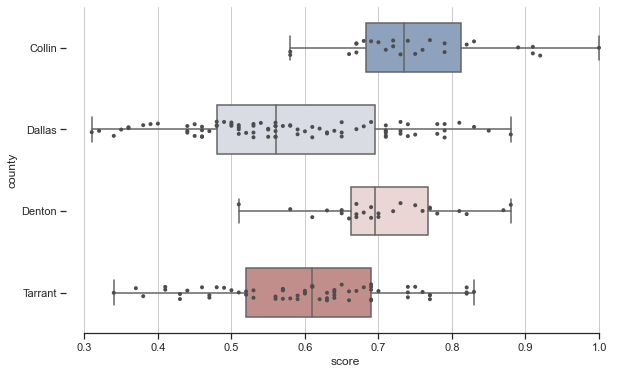

In [22]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(style="ticks")

# Initialize the figure with a linear x axis
f, ax = plt.subplots(figsize=(10, 6))
ax.set_xscale("linear")

# Plot the orbital period with horizontal boxes
sns.boxplot(x="score", y="county_name", data=df_master,
            whis=[0, 100], width=.6, palette="vlag")

# Add in points to show each observation
sns.stripplot(x="score", y="county_name", data=df_master,
              size=4, color=".3", linewidth=0)

# Tweak the visual presentation
ax.xaxis.grid(True)
ax.set(ylabel="county")
sns.despine(trim=True, left=True)

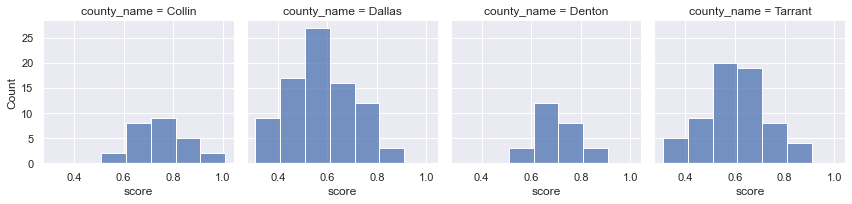

In [48]:
sns.set_theme(style="darkgrid")
#df = sns.load_dataset("penguins")
sns.displot(
    df_master, x="score", col="county_name", #row="sex",
    binwidth=0.1, height=3, facet_kws=dict(margin_titles=True),
)

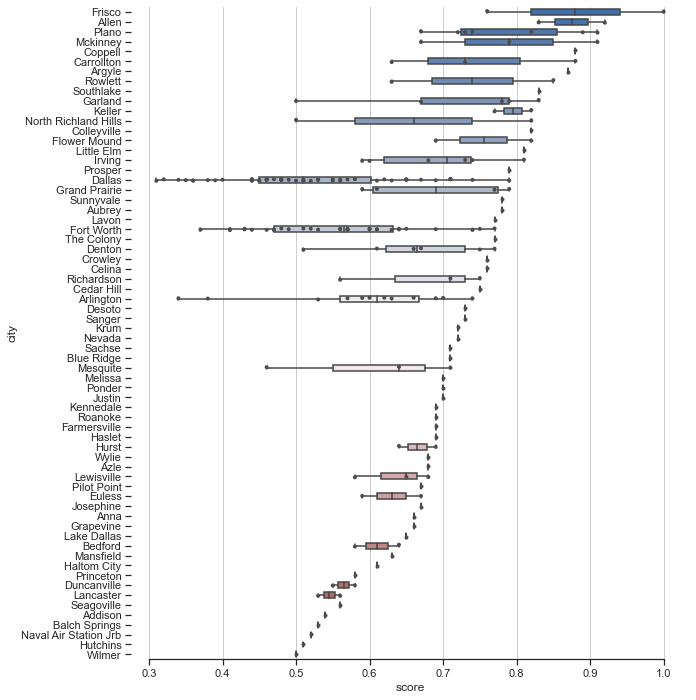

In [24]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(style="ticks")

# Initialize the figure with a linear x axis
f, ax = plt.subplots(figsize=(10, 12))
ax.set_xscale("linear")

# Plot the orbital period with horizontal boxes
sns.boxplot(x="score", y="city", data=df_master,
            whis=[0, 100], width=.6, palette="vlag")

# Add in points to show each observation
sns.stripplot(x="score", y="city", data=df_master,
              size=4, color=".3", linewidth=0)

# Tweak the visual presentation
ax.xaxis.grid(True)
ax.set(ylabel="city")
sns.despine(trim=True, left=True)

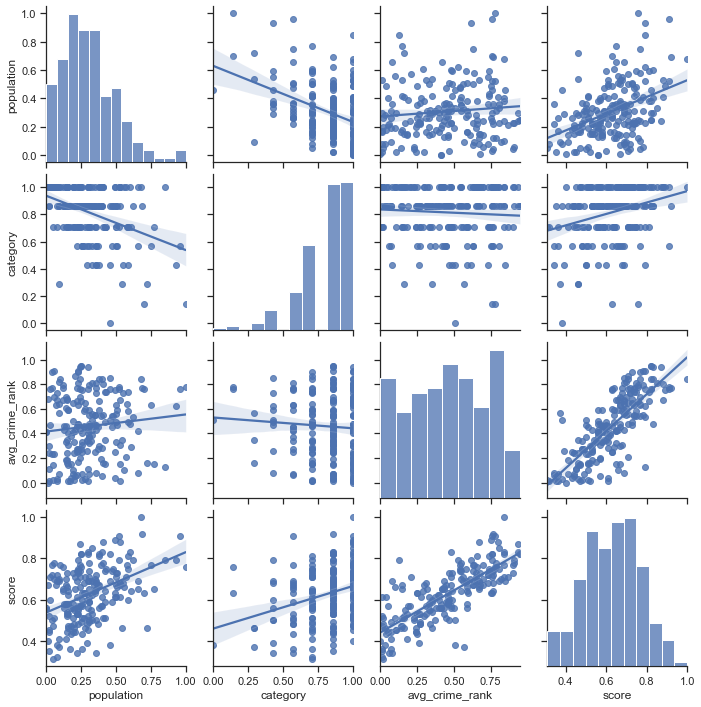

In [25]:
# with regression
sns.pairplot(df_master, kind="reg")
plt.show()
 
# without regression
#sns.pairplot(df_master, kind="scatter")
#plt.show()


### Import and Create a new Geojson for the specified DFW metroplex zipcodes with added properties

In [26]:
# Create a list of all unique zipcodes
df_zip = df['zip']
df_zip.drop_duplicates(keep=False,inplace=True)
zip_list = list(df_zip)

# json data for tooltips

# load GeoJSON
json_file = 'tx_texas_zip_codes_geo.min.json'
with open(json_file, 'r') as jsonFile:
    data = json.load(jsonFile)

tmp = data

# remove ZIP codes not in our dataset and add data to properties for our tooltips
geozips = []
for i in range(len(tmp['features'])):
    if tmp['features'][i]['properties']['ZCTA5CE10'] in list(df_tooltip['zip']):
        properties = tmp['features'][i]
        city = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'city'].item()
        population = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'population'].item()
        restaurant = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'category'].item()
        avg_crime_rank = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'avg_crime_rank'].item()
        score = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'score'].item()
        properties['properties']['city'] = city
        properties['properties']['population'] = population
        properties['properties']['restaurant'] = restaurant
        properties['properties']['avg_crime_rank'] = avg_crime_rank
        properties['properties']['score'] = score
        #print(properties)
        geozips.append(properties)

# creating new JSON object
new_json = dict.fromkeys(['type','features'])
new_json['type'] = 'FeatureCollection'
new_json['features'] = geozips

# save JSON object as updated-file
updated_json = r'updated-file_2.json'
open(updated_json, "w").write(
    json.dumps(new_json, sort_keys=True, indent=4, separators=(',', ': '))
)

21625554

### Create a choropleth map

In [304]:
updated_json = r'updated-file_2.json'


In [27]:
dfw_map = folium.Map(location = [32.860471, -96.987734], zoom_start = 9)

folium.Choropleth(
    geo_data=updated_json,
    data=df_master,
    columns=['zip', 'score'],
    key_on='feature.properties.ZCTA5CE10',
    fill_color='RdYlGn',
    #fill_color='YlGn',
    nan_fill_color='white',
    fill_opacity=0.5,
    line_opacity=0.7,
    legend_name="Rank by Zipcode"
).add_to(dfw_map)

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

tooltips = folium.features.GeoJson(
    updated_json,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['city','ZCTA5CE10','population','restaurant','avg_crime_rank', 'score'],
        aliases=['City: ','Zipcode: ','Population: ','Restaurant Count: ','Avg Crime Rating: ','Score: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
dfw_map.add_child(tooltips)
dfw_map.keep_in_front(tooltips)
folium.LayerControl().add_to(dfw_map)

dfw_map

### Identify and provide our recommended top 20 zipcodes

In [38]:
df_master_adjusted = df_master[df_master.score > .79]
df_master_adjusted.head()
df_master_adjusted.count()

county_name       19
city              19
zip               19
population        19
category          19
avg_crime_rank    19
score             19
dtype: int64

In [39]:
# Create a list of all unique zipcodes
#df_zip = df_master_adjusted['zip'].copy()
#df_zip.drop_duplicates(keep=False,inplace=True)
#zip_list = list(df_zip)

# json data for tooltips

# load GeoJSON
json_file = 'tx_texas_zip_codes_geo.min.json'
with open(json_file, 'r') as jsonFile:
    data = json.load(jsonFile)

tmp = data

geozips = []
for i in range(len(tmp['features'])):
    if tmp['features'][i]['properties']['ZCTA5CE10'] in list(df_master_adjusted['zip']):
        properties = tmp['features'][i]
        city = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'city'].item()
        population = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'population'].item()
        restaurant = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'category'].item()
        avg_crime_rank = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'avg_crime_rank'].item()
        score = df_tooltip.loc[df_tooltip['zip'] == tmp['features'][i]['properties']['ZCTA5CE10'], 'score'].item()
        properties['properties']['city'] = city
        properties['properties']['population'] = population
        properties['properties']['restaurant'] = restaurant
        properties['properties']['avg_crime_rank'] = avg_crime_rank
        properties['properties']['score'] = score
        geozips.append(properties)

# creating new JSON object
new_json = dict.fromkeys(['type','features'])
new_json['type'] = 'FeatureCollection'
new_json['features'] = geozips

# save JSON object as updated-file
updated_json_adjusted = r'updated-file_2_adjusted.json'
open(updated_json_adjusted, "w").write(
    json.dumps(new_json, sort_keys=True, indent=4, separators=(',', ': '))
)

2177085

In [40]:
dfw_map = folium.Map(location = [32.860471, -96.987734], zoom_start = 9)

folium.Choropleth(
    geo_data=updated_json,
    data=df_master,
    columns=['zip', 'score'],
    key_on='feature.properties.ZCTA5CE10',
    fill_color='RdYlGn',
    #fill_color='YlGn',
    nan_fill_color='white',
    fill_opacity=0.5,
    line_opacity=0.7,
    legend_name="Rank by Zipcode"
).add_to(dfw_map)

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

tooltips = folium.features.GeoJson(
    updated_json,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['city','ZCTA5CE10','population','restaurant','avg_crime_rank', 'score'],
        aliases=['City: ','Zipcode: ','Population: ','Restaurant Count: ','Avg Crime Rating: ','Score: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)

dfw_map.add_child(tooltips)
dfw_map.keep_in_front(tooltips)

top_areas = folium.GeoJson(
    updated_json_adjusted,
    style_function=lambda feature: {
        'fillColor': 'green',
        'color' : 'green',
        'weight' : 3,
        'fillOpacity' : 0.1,
        }
)

dfw_map.add_child(top_areas)
folium.LayerControl().add_to(dfw_map)
dfw_map

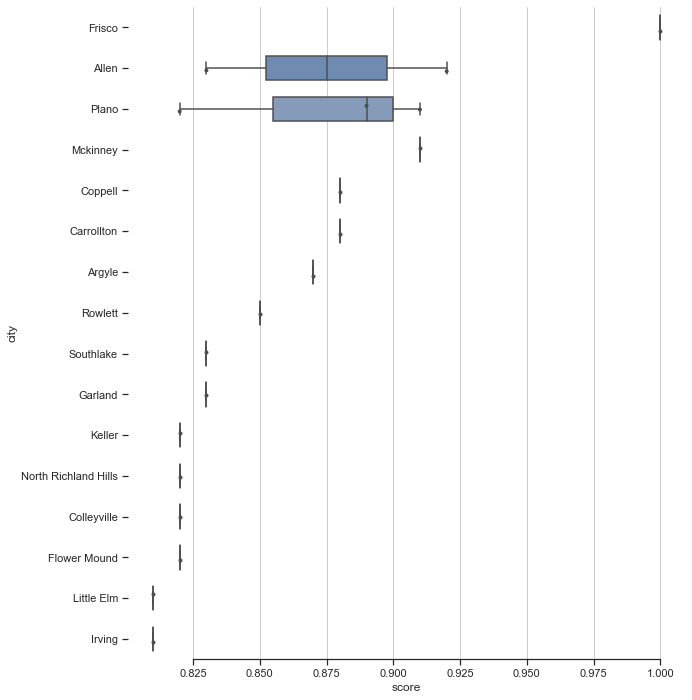

In [45]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(style="ticks")

# Initialize the figure with a linear x axis
f, ax = plt.subplots(figsize=(10, 12))
ax.set_xscale("linear")

# Plot the orbital period with horizontal boxes
sns.boxplot(x="score", y="city", data=df_master_adjusted,
            whis=[0, 100], width=.6, palette="vlag")

# Add in points to show each observation
sns.stripplot(x="score", y="city", data=df_master_adjusted,
              size=4, color=".3", linewidth=0)

# Tweak the visual presentation
ax.xaxis.grid(True)
ax.set(ylabel="city")
sns.despine(trim=True, left=True)